# Predicting Road Accident Risk

- `accident_risk` is the continuous [0-1] target ground truth

In [1]:
# import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


import mlflow
import mlflow.sklearn

# set random seed for reproducibility
np.random.seed(42)

# load dataset
data = pd.read_csv('data/train.csv')

# suffle the dataset
data = data.sample(frac=1).reset_index(drop=True)

## 1.0 Split the data

Now I will split the data and save part for testing.

Data has been split and saved.


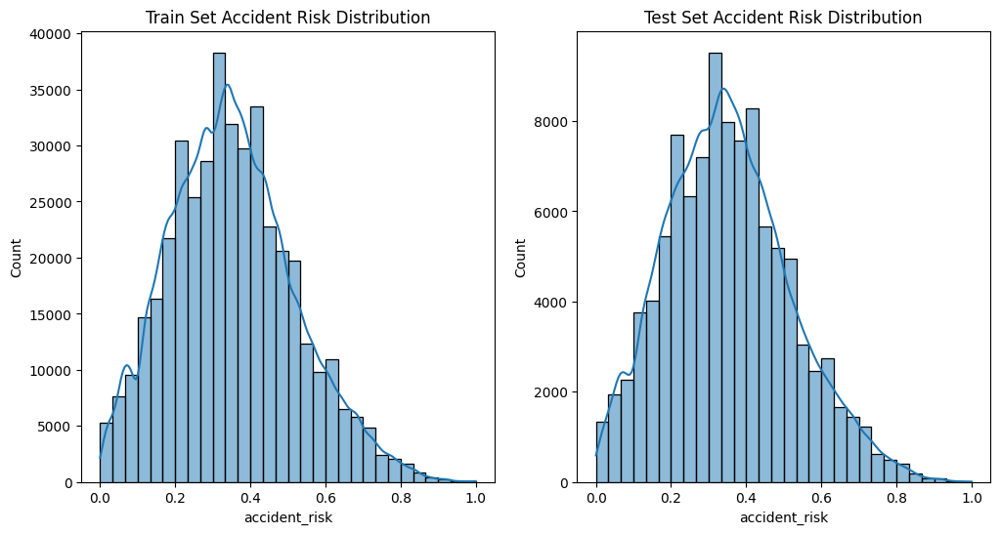

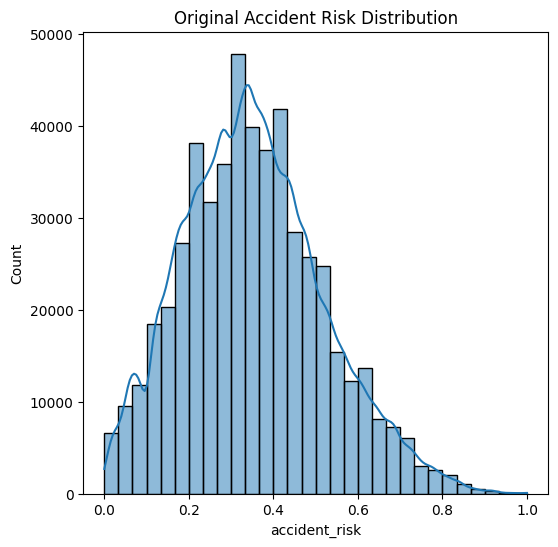

In [2]:
# stratified split
from sklearn.model_selection import train_test_split


# create bins for stratification
num_bins = 10
data["bins"] = pd.qcut(data["accident_risk"], q=num_bins, duplicates="drop")

train_data, test_data = train_test_split(data,
                                        test_size=0.2, stratify=data["bins"], random_state=42)

# save the split datasets
train_data.to_csv('data/train_split.csv', index=False)
test_data.to_csv('data/test_split.csv', index=False)

print("Data has been split and saved.")

# plot the distribution of the target variable in the splits
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.histplot(train_data['accident_risk'], bins=30, kde=True)
plt.title('Train Set Accident Risk Distribution')
plt.subplot(1, 2, 2)
sns.histplot(test_data['accident_risk'], bins=30, kde=True)
plt.title('Test Set Accident Risk Distribution')
plt.show()

# plot the original distribution for comparison
plt.figure(figsize=(6, 6))
sns.histplot(data['accident_risk'], bins=30, kde=True)
plt.title('Original Accident Risk Distribution')
plt.show()


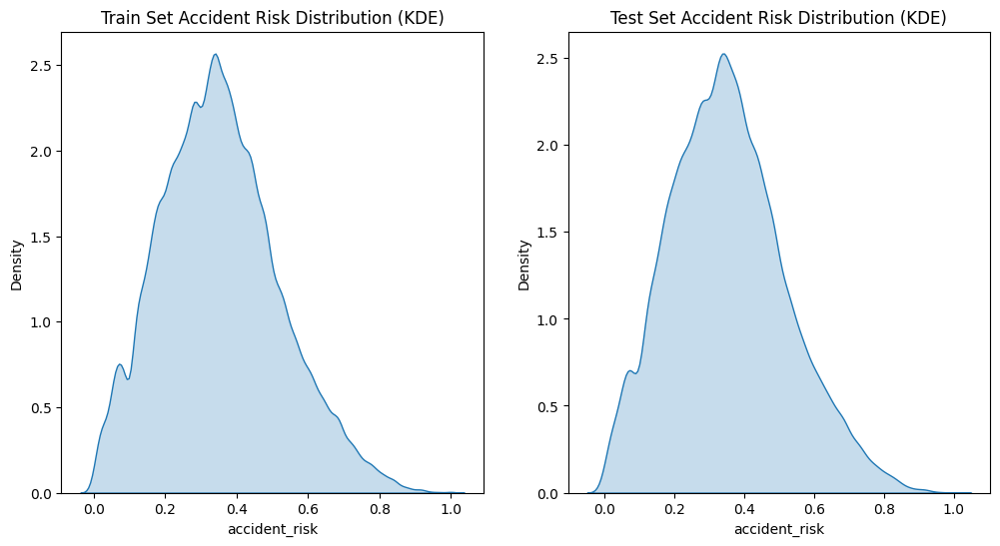

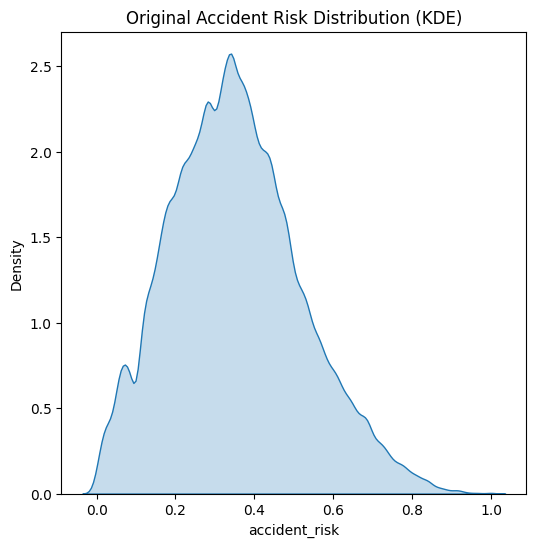

In [3]:
# plot kde plots for better visualization
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.kdeplot(train_data['accident_risk'], fill=True)
plt.title('Train Set Accident Risk Distribution (KDE)')
plt.subplot(1, 2, 2)
sns.kdeplot(test_data['accident_risk'], fill=True)
plt.title('Test Set Accident Risk Distribution (KDE)')
plt.show()

# plot the original distribution for comparison
plt.figure(figsize=(6, 6))
sns.kdeplot(data['accident_risk'], fill=True)
plt.title('Original Accident Risk Distribution (KDE)')
plt.show()

We can see that these curves are very similar, so we can start exploring the train data.

In [4]:
# let's remove the bins column from the datasets
train_data = train_data.drop(columns=['bins'])
test_data = test_data.drop(columns=['bins'])
data = data.drop(columns=['bins'])

## 2.0 EAD - Train data

In [5]:
# get familiar with the data
print(train_data.info())

<class 'pandas.core.frame.DataFrame'>
Index: 414203 entries, 411301 to 203221
Data columns (total 14 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   id                      414203 non-null  int64  
 1   road_type               414203 non-null  object 
 2   num_lanes               414203 non-null  int64  
 3   curvature               414203 non-null  float64
 4   speed_limit             414203 non-null  int64  
 5   lighting                414203 non-null  object 
 6   weather                 414203 non-null  object 
 7   road_signs_present      414203 non-null  bool   
 8   public_road             414203 non-null  bool   
 9   time_of_day             414203 non-null  object 
 10  holiday                 414203 non-null  bool   
 11  school_season           414203 non-null  bool   
 12  num_reported_accidents  414203 non-null  int64  
 13  accident_risk           414203 non-null  float64
dtypes: bool(4), float64(

In [6]:
print(train_data.describe())

                  id      num_lanes      curvature    speed_limit  \
count  414203.000000  414203.000000  414203.000000  414203.000000   
mean   258797.164670       2.491406       0.488859      46.113355   
std    149379.916054       1.119954       0.272468      15.782487   
min         1.000000       1.000000       0.000000      25.000000   
25%    129483.500000       1.000000       0.260000      35.000000   
50%    258668.000000       2.000000       0.510000      45.000000   
75%    388063.500000       3.000000       0.710000      60.000000   
max    517753.000000       4.000000       1.000000      70.000000   

       num_reported_accidents  accident_risk  
count           414203.000000  414203.000000  
mean                 1.187712       0.352384  
std                  0.895820       0.166463  
min                  0.000000       0.000000  
25%                  1.000000       0.230000  
50%                  1.000000       0.340000  
75%                  2.000000       0.460000  
ma

In [7]:
# display the first few rows of the dataset
print(train_data.head())

            id road_type  num_lanes  curvature  speed_limit  lighting weather  \
411301  163141     rural          2       0.14           60       dim   rainy   
364095  453971     rural          4       0.12           60  daylight   rainy   
332640  478569   highway          4       0.72           70  daylight   foggy   
27202    17719   highway          3       0.04           25     night   foggy   
244922  145471     urban          1       0.85           25       dim   foggy   

        road_signs_present  public_road time_of_day  holiday  school_season  \
411301               False         True     evening     True           True   
364095               False        False     morning     True          False   
332640               False         True   afternoon    False           True   
27202                 True        False     morning     True           True   
244922               False        False   afternoon    False          False   

        num_reported_accidents  accide

In [8]:
# we can remove 'id' column as it is not useful for prediction
train_data = train_data.drop(columns=['id'])
test_data = test_data.drop(columns=['id'])


In [9]:
# check for missing values
# this is just to confirm, alhought we see from info() that there are no missing values
print(train_data.isnull().sum())

road_type                 0
num_lanes                 0
curvature                 0
speed_limit               0
lighting                  0
weather                   0
road_signs_present        0
public_road               0
time_of_day               0
holiday                   0
school_season             0
num_reported_accidents    0
accident_risk             0
dtype: int64


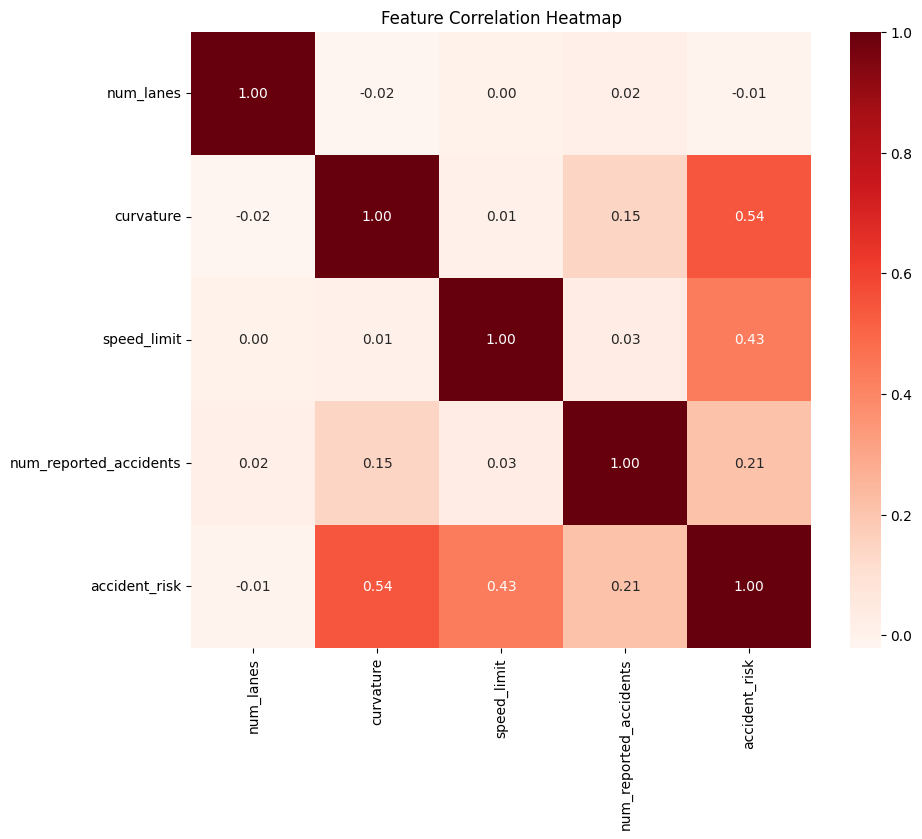

In [10]:
# plot correlation heatmap
plt.figure(figsize=(10, 8))
corr = train_data.select_dtypes(include=[np.number]).corr()
sns.heatmap(corr, annot=True, fmt=".2f", cmap='Reds')
plt.title('Feature Correlation Heatmap')
plt.show()

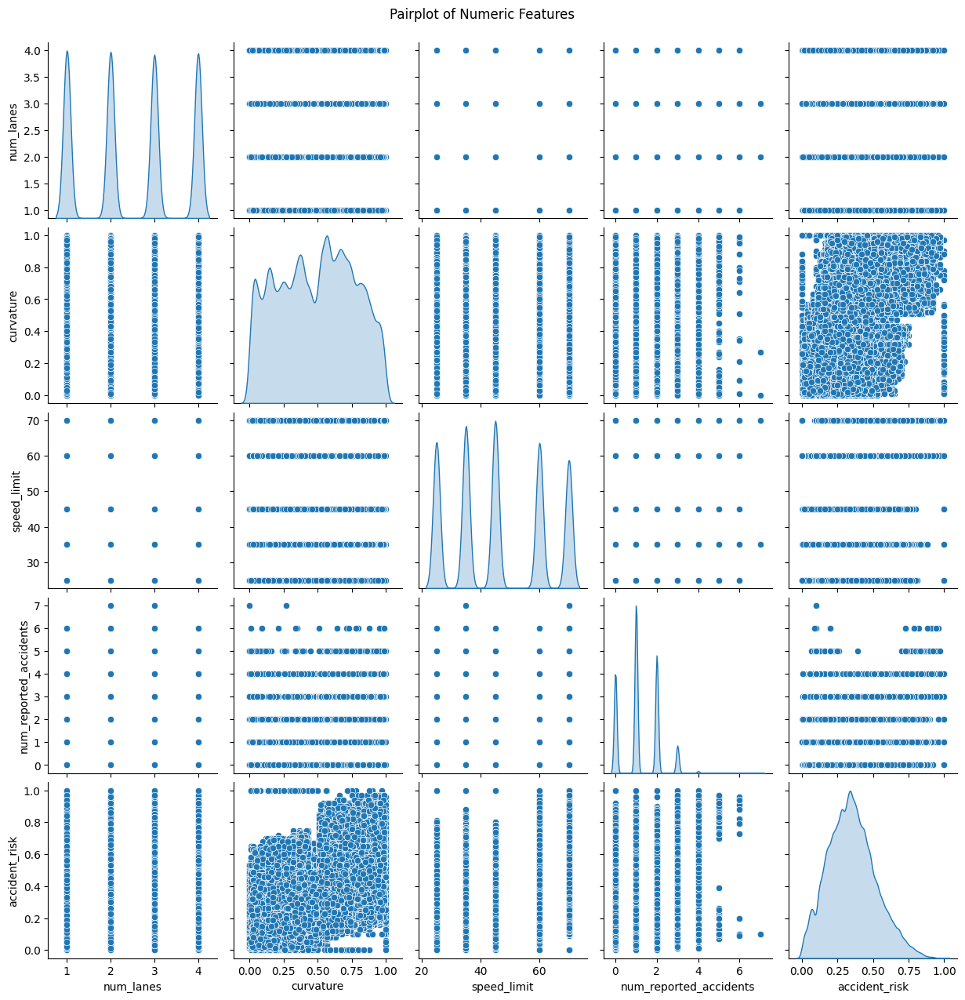

In [11]:
# display the pairplot of the numeric features and the target variable
numeric_features = train_data.select_dtypes(include=[np.number]).columns.tolist()
sns.pairplot(train_data[numeric_features], diag_kind='kde')
plt.suptitle('Pairplot of Numeric Features', y=1.02)
plt.show()

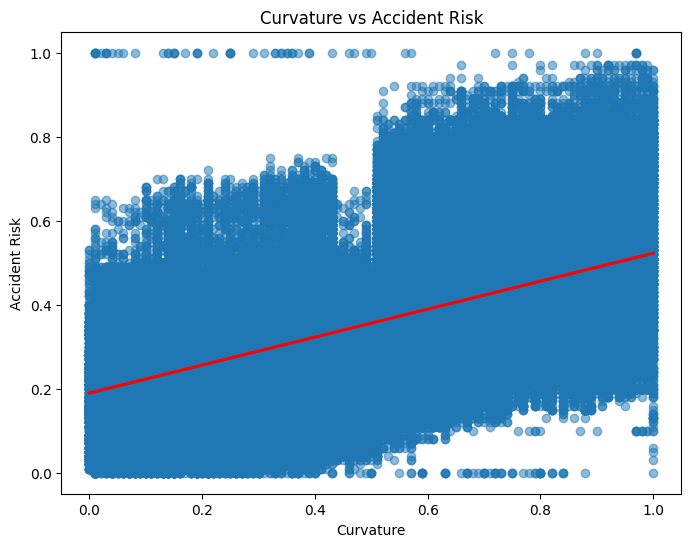

In [12]:
# plot curvature vs accident_risk
plt.figure(figsize=(8, 6))
sns.regplot(
    x='curvature',
    y='accident_risk',
    data=train_data,
    scatter_kws={'alpha': 0.5},
    line_kws={'color': 'red'}
)
plt.title('Curvature vs Accident Risk')
plt.xlabel('Curvature')
plt.ylabel('Accident Risk')
plt.show()

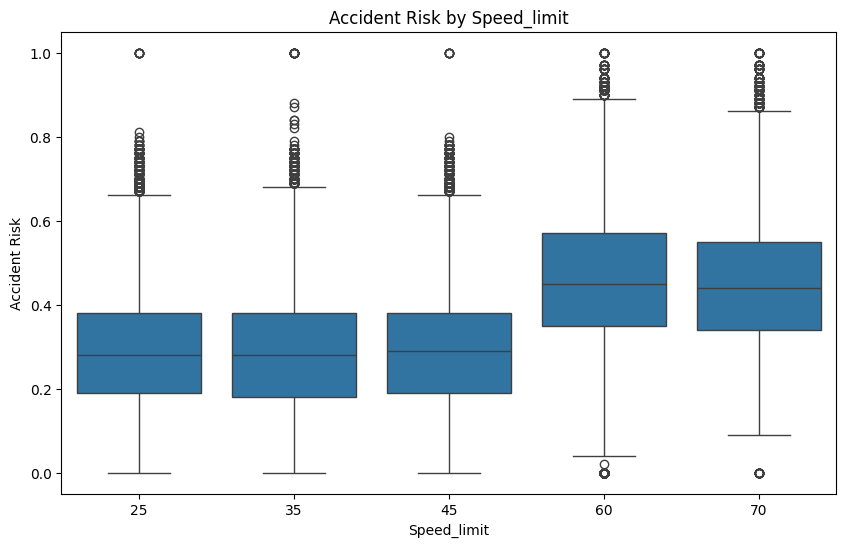

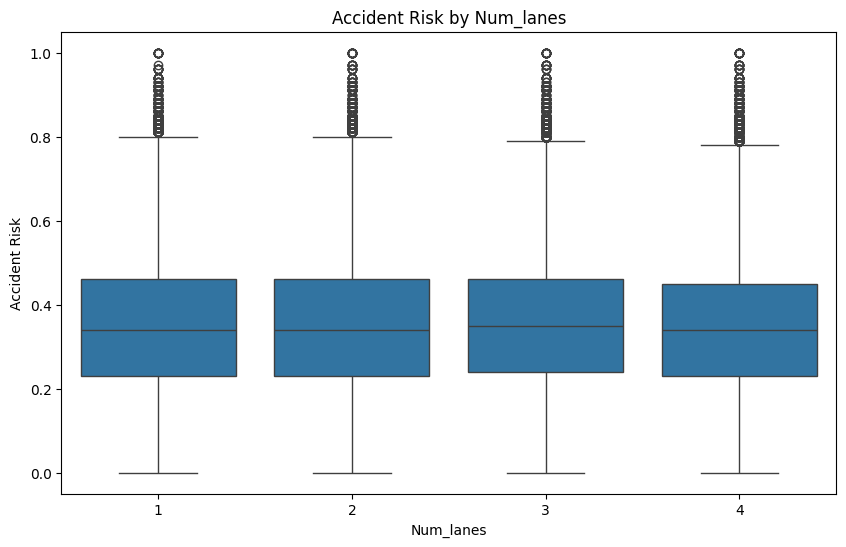

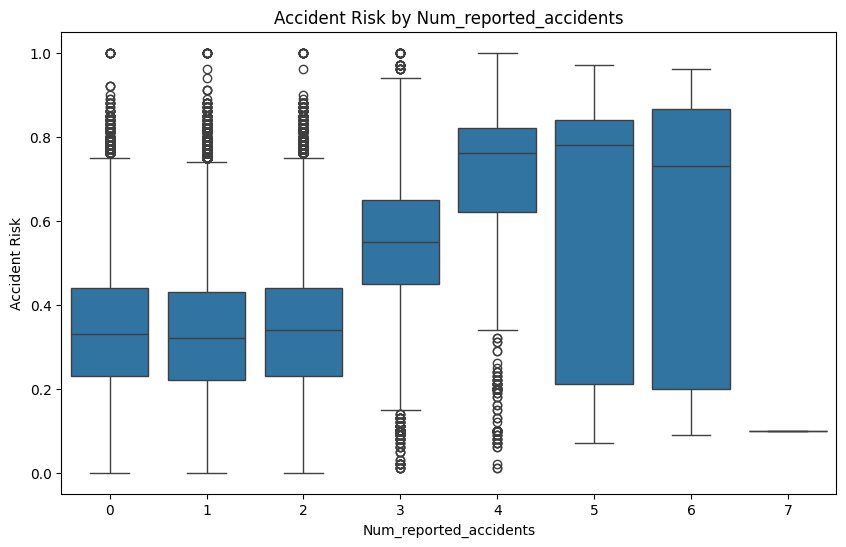

In [13]:
# check the distribution of the numeric - categorical features
numeric_categorical_features = ['speed_limit', 'num_lanes', 'num_reported_accidents']
for feature in numeric_categorical_features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=feature, y='accident_risk', data=train_data)
    plt.title(f'Accident Risk by {feature.capitalize()}')
    plt.xlabel(feature.capitalize())
    plt.ylabel('Accident Risk')
    plt.show()

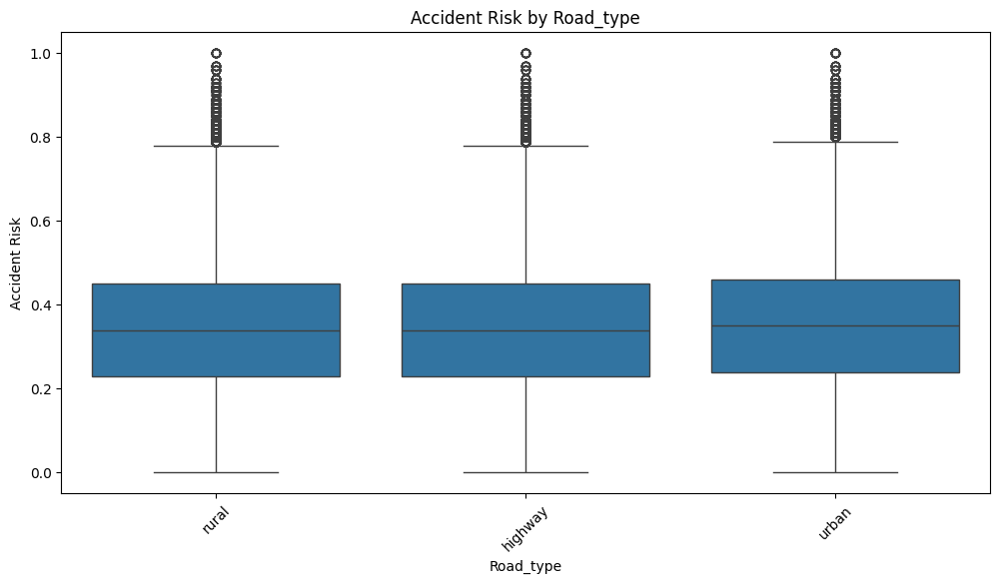

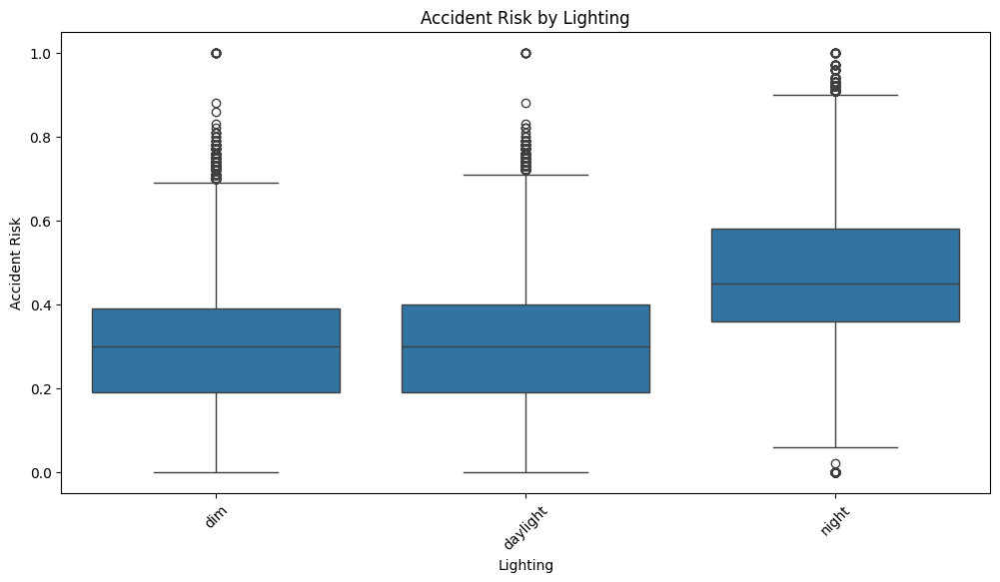

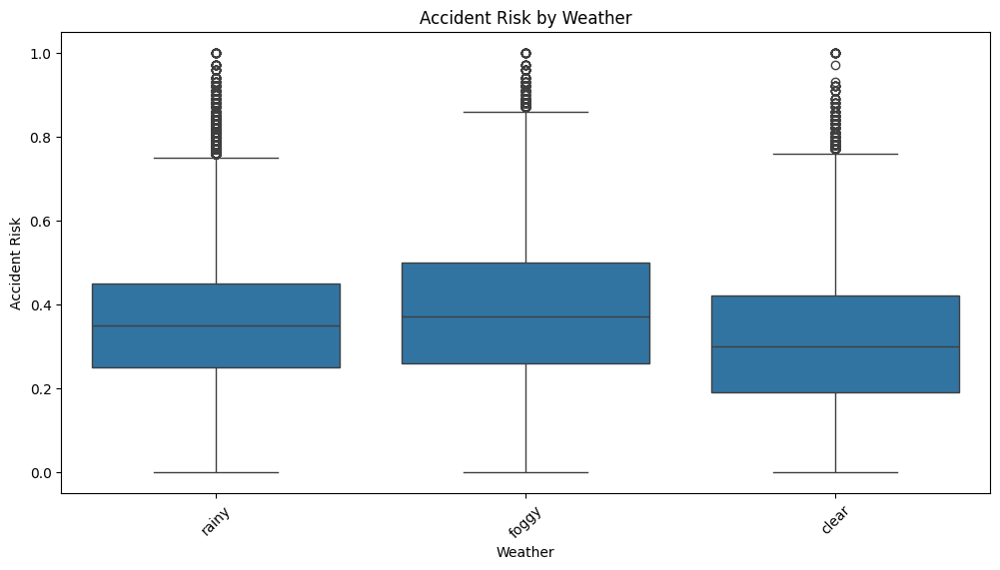

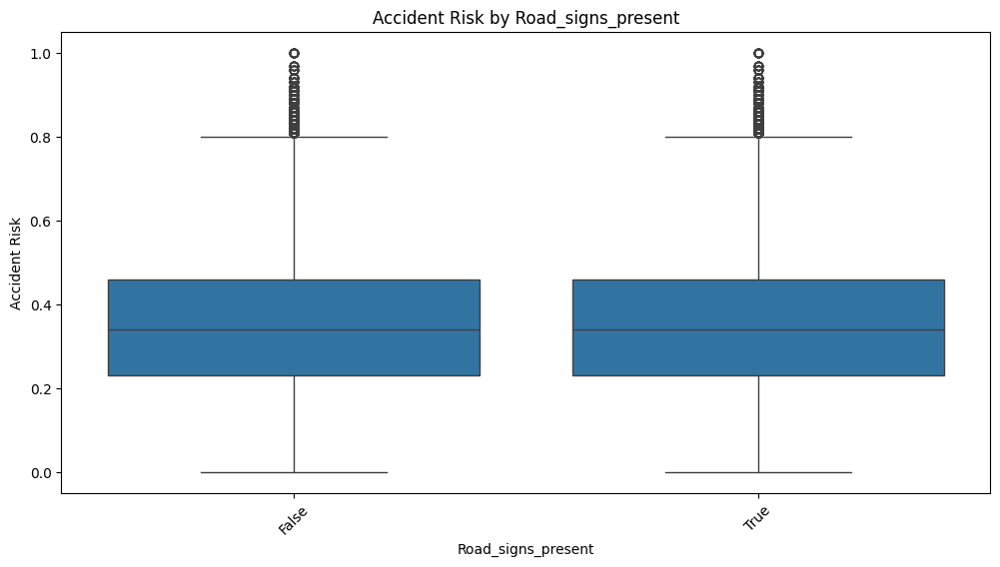

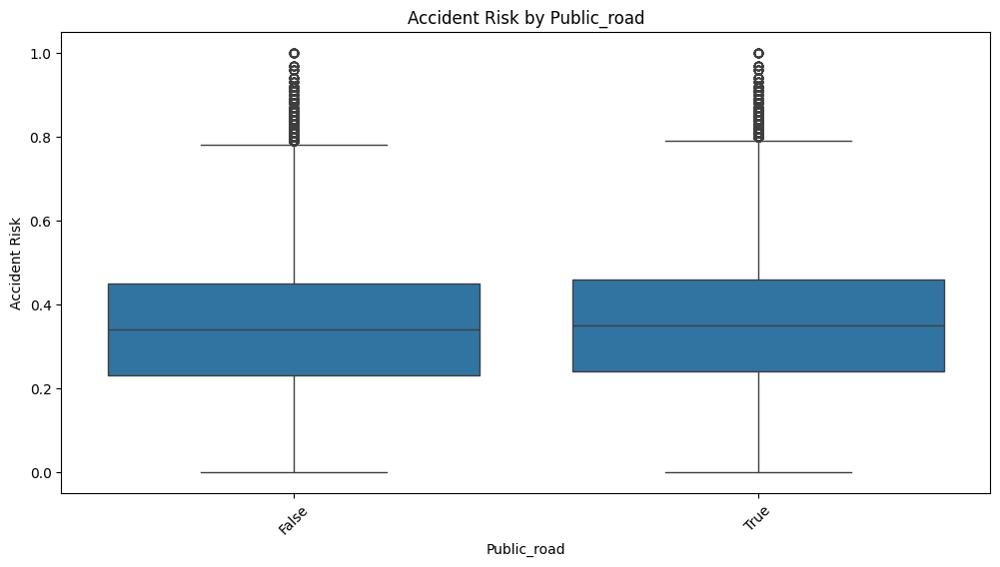

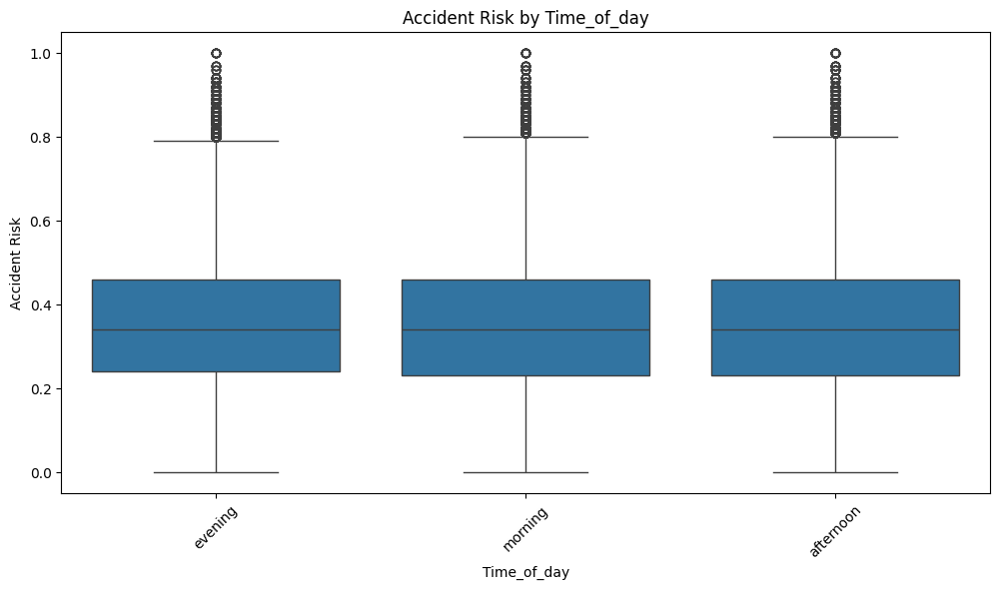

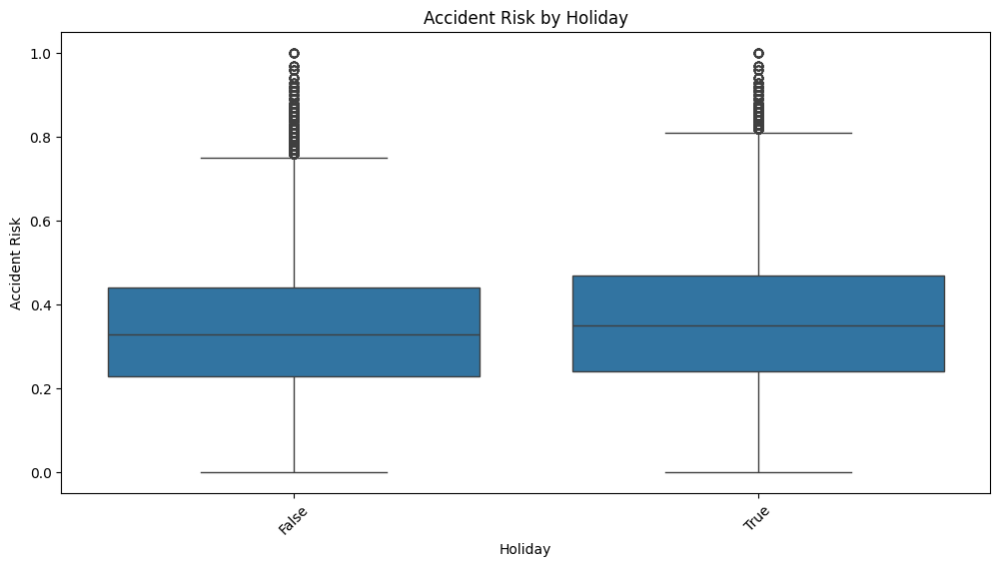

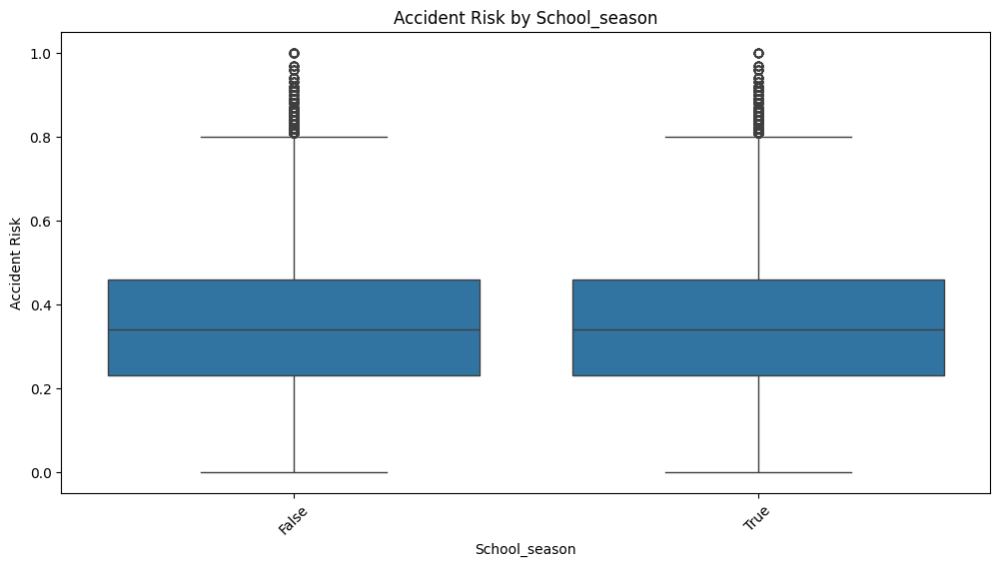

In [14]:
# check the distribution of the categorial features (dtype = object)
categorical_features = train_data.select_dtypes(include=['object', 'bool']).columns.tolist()
for feature in categorical_features:
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=feature, y='accident_risk', data=train_data)
    plt.title(f'Accident Risk by {feature.capitalize()}')
    plt.xlabel(feature.capitalize())
    plt.ylabel('Accident Risk')
    plt.xticks(rotation=45)
    plt.show()

In [15]:
print (categorical_features)

['road_type', 'lighting', 'weather', 'road_signs_present', 'public_road', 'time_of_day', 'holiday', 'school_season']


In [16]:
# use information theory to find the most important categorical features
# might take a few seconds to run

from sklearn.feature_selection import mutual_info_regression

categorical_features += numeric_categorical_features # include as categorical


categorical_data = train_data[categorical_features].apply(lambda x: x.astype('category').cat.codes)

mi_scores = mutual_info_regression(categorical_data, train_data['accident_risk'])
mi_scores = pd.Series(mi_scores, index=categorical_features).sort_values(ascending=False)

print("Mutual Information Scores for Categorical Features:")
print(mi_scores)

Mutual Information Scores for Categorical Features:
speed_limit               0.148767
lighting                  0.132219
num_reported_accidents    0.071797
weather                   0.033002
public_road               0.002864
road_signs_present        0.001809
road_type                 0.001607
holiday                   0.001345
time_of_day               0.001040
school_season             0.000780
num_lanes                 0.000677
dtype: float64


**Learnings:**

- `curvature` and `speed_limit` ar the numeric variables with highest correlation to `accident_risk`; followed by `num_reported_accidents`; `num_lanes` is weekly correlated (-0.01).
- `num_lanes` is likely to have little / no / negative effect on the training due to low correlation and similar distribution accross all categories. 
- `time_of_the_day` and `road_type` seen to have no relationship with `accident_risk` upon visual inspection.
- only `curvature` is a float. The others are numeric but can be seem as `categorical` (potential to explore binary classifiers)
- some numerics (like `num_lanes`, `speed_limit`, `num_reported_accidents`) may actually represent categories or discrete buckets, not truly continuous measurements.
- Only `curvature` behaves like a continuous variable.

**GOAL**
> “Treat everything except curvature as categorical — efficiently, and in a way compatible with ML models.”

**Ideas for feature engineering**
- Remove `num_lanes`, `road_type`from training (low evidence); likely remove `time_of_the_day`
- Test if normalising `curvature` can lead to improvement
- Use `num_reported_accidents` as categories: up to 2, More than 4.
- Keep only features with a mutual information score anove a limit (from `road_type` at least)

## 3.0 Treat data before first model

In [17]:
# display the first few rows of the dataset
print(train_data.head())

       road_type  num_lanes  curvature  speed_limit  lighting weather  \
411301     rural          2       0.14           60       dim   rainy   
364095     rural          4       0.12           60  daylight   rainy   
332640   highway          4       0.72           70  daylight   foggy   
27202    highway          3       0.04           25     night   foggy   
244922     urban          1       0.85           25       dim   foggy   

        road_signs_present  public_road time_of_day  holiday  school_season  \
411301               False         True     evening     True           True   
364095               False        False     morning     True          False   
332640               False         True   afternoon    False           True   
27202                 True        False     morning     True           True   
244922               False        False   afternoon    False          False   

        num_reported_accidents  accident_risk  
411301                       1        

In [18]:
train_data.info()

# drop index
train_data = train_data.reset_index(drop=True)
test_data = test_data.reset_index(drop=True)



<class 'pandas.core.frame.DataFrame'>
Index: 414203 entries, 411301 to 203221
Data columns (total 13 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   road_type               414203 non-null  object 
 1   num_lanes               414203 non-null  int64  
 2   curvature               414203 non-null  float64
 3   speed_limit             414203 non-null  int64  
 4   lighting                414203 non-null  object 
 5   weather                 414203 non-null  object 
 6   road_signs_present      414203 non-null  bool   
 7   public_road             414203 non-null  bool   
 8   time_of_day             414203 non-null  object 
 9   holiday                 414203 non-null  bool   
 10  school_season           414203 non-null  bool   
 11  num_reported_accidents  414203 non-null  int64  
 12  accident_risk           414203 non-null  float64
dtypes: bool(4), float64(2), int64(3), object(4)
memory usage: 33.2+ MB


In [19]:
# safe
# separate categorical and numerical features
num_cols = ['curvature']
cat_cols = [col for col in train_data.columns if col not in num_cols]

cat_cols.remove('accident_risk')  # remove target variable if present

def vectorize_ready(X, num_cols, cat_cols):
    # convert all categorical-like features to string
    for col in cat_cols:
        X[col] = X[col].astype(str)
    
    # drop target variable if present
    if 'accident_risk' in X.columns:
        X = X.drop(columns=['accident_risk'])

    # drop index if present
    if 'index' in X.columns:
        X = X.drop(columns=['index'])

    
    X_train_dict = X[num_cols + cat_cols].to_dict(orient='records')

    return X_train_dict


In [20]:
train_data

,road_type,num_lanes,curvature,speed_limit,lighting,weather,road_signs_present,public_road,time_of_day,holiday,school_season,num_reported_accidents,accident_risk
0,rural,2,0.14,60,dim,rainy,False,True,evening,True,True,1,0.33
1,rural,4,0.12,60,daylight,rainy,False,False,morning,True,False,0,0.31
2,highway,4,0.72,70,daylight,foggy,False,True,afternoon,False,True,0,0.49
3,highway,3,0.04,25,night,foggy,True,False,morning,True,True,0,0.30
4,urban,1,0.85,25,dim,foggy,False,False,afternoon,False,False,0,0.35
...,...,...,...,...,...,...,...,...,...,...,...,...,...
414198,highway,3,0.57,45,night,foggy,False,True,morning,True,False,1,0.49
414199,highway,1,0.62,35,night,clear,False,True,evening,True,True,1,0.33
414200,rural,4,0.70,45,night,rainy,False,True,morning,True,False,1,0.48
414201,urban,4,0.77,70,night,clear,True,True,morning,True,True,1,0.71


In [21]:
from sklearn.feature_extraction import DictVectorizer

# create a DictVectorizer instance
dv = DictVectorizer(sparse=False)

# prepare the data for vectorization
y_train_all = train_data['accident_risk']
X_train_all = train_data.drop(columns=['accident_risk'])

print(X_train_all.dtypes)




road_type                  object
num_lanes                   int64
curvature                 float64
speed_limit                 int64
lighting                   object
weather                    object
road_signs_present           bool
public_road                  bool
time_of_day                object
holiday                      bool
school_season                bool
num_reported_accidents      int64
dtype: object


In [22]:
cat_cols

['road_type',
 'num_lanes',
 'speed_limit',
 'lighting',
 'weather',
 'road_signs_present',
 'public_road',
 'time_of_day',
 'holiday',
 'school_season',
 'num_reported_accidents']

In [23]:
X_train_dict = vectorize_ready(X_train_all, num_cols, cat_cols)

In [24]:
X_train_dict[0]

{'curvature': 0.14,
 'road_type': 'rural',
 'num_lanes': '2',
 'speed_limit': '60',
 'lighting': 'dim',
 'weather': 'rainy',
 'road_signs_present': 'False',
 'public_road': 'True',
 'time_of_day': 'evening',
 'holiday': 'True',
 'school_season': 'True',
 'num_reported_accidents': '1'}

In [25]:
X_train_dict = vectorize_ready(X_train_all, num_cols, cat_cols)

X_train = dv.fit_transform(X_train_dict)

print(f"Number of features after one-hot encoding: {X_train.shape[1]}")

Number of features after one-hot encoding: 38


In [ ]:
# train a simple linear regression model to check if everything is working fine
from sklearn.linear_model import LinearRegression
from sklearn.metrics import root_mean_squared_error

lr = LinearRegression()
lr.fit(X_train, y_train_all)

# check RMSE on train set
y_train_pred = lr.predict(X_train)
print(f"RSME on train set: {root_mean_squared_error(y_train_all, y_train_pred)}")

# prepare the test set
X_test = test_data.drop(columns=['accident_risk'])
y_test = test_data['accident_risk']
X_test_dict = vectorize_ready(X_test, num_cols, cat_cols)
X_test = dv.transform(X_test_dict)

# predict on test set and calculate RMSE
y_test_pred = lr.predict(X_test)

print(f"RSME on test set: {root_mean_squared_error(y_test, y_test_pred)}")




RSME on train set: 0.058098785835748235
RSME on train set: 0.05770416486133259


In [30]:
# let's remove the features with very low importance according to mutual information scores
important_features = mi_scores[mi_scores > 0.01].index.tolist()

print(f"Important features: {important_features}")

Important features: ['speed_limit', 'lighting', 'num_reported_accidents', 'weather']


In [34]:
num_cols=['curvature']
cat_cols=important_features

X_train_all = vectorize_ready(train_data.drop(columns=['accident_risk']), num_cols, cat_cols)
y_train_all = train_data['accident_risk']

X_train_dict = dv.fit_transform(X_train_all)

print(X_train_all)

[{'curvature': 0.14, 'speed_limit': '60', 'lighting': 'dim', 'num_reported_accidents': '1', 'weather': 'rainy'}, {'curvature': 0.12, 'speed_limit': '60', 'lighting': 'daylight', 'num_reported_accidents': '0', 'weather': 'rainy'}, {'curvature': 0.72, 'speed_limit': '70', 'lighting': 'daylight', 'num_reported_accidents': '0', 'weather': 'foggy'}, {'curvature': 0.04, 'speed_limit': '25', 'lighting': 'night', 'num_reported_accidents': '0', 'weather': 'foggy'}, {'curvature': 0.85, 'speed_limit': '25', 'lighting': 'dim', 'num_reported_accidents': '0', 'weather': 'foggy'}, {'curvature': 0.29, 'speed_limit': '25', 'lighting': 'daylight', 'num_reported_accidents': '1', 'weather': 'clear'}, {'curvature': 0.7, 'speed_limit': '35', 'lighting': 'dim', 'num_reported_accidents': '2', 'weather': 'foggy'}, {'curvature': 0.27, 'speed_limit': '60', 'lighting': 'dim', 'num_reported_accidents': '0', 'weather': 'clear'}, {'curvature': 0.65, 'speed_limit': '25', 'lighting': 'dim', 'num_reported_accidents': '

In [36]:
# prepare the new data for vectorization
num_cols=['curvature']
cat_cols=important_features

# prepare the data for vectorization
y_train_all = train_data['accident_risk']
X_train_all = train_data.drop(columns=['accident_risk'])

X_train_dict = vectorize_ready(X_train_all, num_cols, cat_cols)

X_train = dv.fit_transform(X_train_dict)

# check number of features after one-hot encoding
print(f"Number of features after one-hot encoding: {X_train.shape[1]}")

# fit simple linear regression model again
lr = LinearRegression()
lr.fit(X_train, y_train_all)

# check RMSE on train set
y_train_pred = lr.predict(X_train)
print(f"RSME on train set: {root_mean_squared_error(y_train_all, y_train_pred)}")

# prepare the test set again
X_test = test_data.drop(columns=['accident_risk'])
y_test = test_data['accident_risk']

X_test_dict = vectorize_ready(X_test, num_cols, cat_cols)
X_test = dv.transform(X_test_dict)

# predict on test set and calculate RMSE    
y_test_pred = lr.predict(X_test)
print(f"RSME on test set: {root_mean_squared_error(y_test, y_test_pred)}")

Number of features after one-hot encoding: 20
RSME on train set: 0.058096520292388945
RSME on test set: 0.05770806668693705


## Define function to submit to Kaggle

In [48]:
# define function to create file to submit to kaggle
def create_submission_file(test_data, y_pred, filename='submission.csv'):
    submission = pd.DataFrame({
        'id': test_data['id'],
        'accident_risk': np.round(y_pred, 3)
    })
    submission.to_csv(filename, index=False)
    print(f"Submission file '{filename}' created.")

def predict_and_create_submission(num_cols, cat_cols, model, dv, filename='submission.csv'):
    #X_test = test_data.drop(columns=['accident_risk'])
    X_test = pd.read_csv('data/test.csv')
    test_data = X_test.copy()
    
    X_test_dict = vectorize_ready(X_test, num_cols, cat_cols)
    X_test = dv.transform(X_test_dict)
    y_test_pred = model.predict(X_test)
    create_submission_file(test_data, y_test_pred, filename)

In [49]:
print(num_cols)
print(cat_cols)

predict_and_create_submission(num_cols, cat_cols, model=lr, dv=dv, filename='submission.csv')

['curvature']
['speed_limit', 'lighting', 'num_reported_accidents', 'weather']
Submission file 'submission.csv' created.


**DUMMY REFERENCE: RSME test: 0.5777**

## Inspecting the first model

In [50]:
## inspecting the first model
# let's look at the coefficients of the linear regression model
feature_names = dv.get_feature_names_out()
coefficients = lr.coef_

# create a dataframe to display feature names and their corresponding coefficients
coef_df = pd.DataFrame({
    'Feature': feature_names,
    'Coefficient': coefficients
})

# sort the dataframe by absolute value of coefficients
coef_df['Abs_Coefficient'] = coef_df['Coefficient'].abs()
coef_df = coef_df.sort_values(by='Abs_Coefficient', ascending=False).drop(columns=['Abs_Coefficient'])
print(coef_df.head(20))

                     Feature   Coefficient
7   num_reported_accidents=3  3.832565e+10
8   num_reported_accidents=4  3.832565e+10
9   num_reported_accidents=5  3.832565e+10
10  num_reported_accidents=6  3.832565e+10
4   num_reported_accidents=0  3.832565e+10
6   num_reported_accidents=2  3.832565e+10
5   num_reported_accidents=1  3.832565e+10
11  num_reported_accidents=7  3.832565e+10
14            speed_limit=45 -1.818411e+10
12            speed_limit=25 -1.818411e+10
13            speed_limit=35 -1.818411e+10
15            speed_limit=60 -1.818411e+10
16            speed_limit=70 -1.818411e+10
17             weather=clear -8.361257e+09
18             weather=foggy -8.361257e+09
19             weather=rainy -8.361257e+09
1          lighting=daylight -3.372468e+09
2               lighting=dim -3.372468e+09
3             lighting=night -3.372468e+09
0                  curvature  3.045727e-01


In [55]:
print(lr.intercept_)

-8407820294.452348


In [56]:
## test a simple tree-based model
from sklearn.ensemble import RandomForestRegressor

rf = RandomForestRegressor(n_estimators=100, random_state=42)

# prepare the new data for vectorization
num_cols=['curvature']
cat_cols=important_features

# prepare the data for vectorization
y_train_all = train_data['accident_risk']
X_train_all = train_data.drop(columns=['accident_risk'])

X_train_dict = vectorize_ready(X_train_all, num_cols, cat_cols)
X_train = dv.fit_transform(X_train_dict)

# fit random forest model
rf.fit(X_train, y_train_all)

# check RMSE on train set
y_train_pred = rf.predict(X_train)
print(f"RSME on train set: {root_mean_squared_error(y_train_all, y_train_pred)}")

# prepare the test set again
X_test = test_data.drop(columns=['accident_risk'])
y_test = test_data['accident_risk']

X_test_dict = vectorize_ready(X_test, num_cols, cat_cols)
X_test = dv.transform(X_test_dict)

# predict on test set and calculate RMSE
y_test_pred = rf.predict(X_test)
print(f"RSME on test set: {root_mean_squared_error(y_test, y_test_pred)}")



RSME on train set: 0.054806632685419035
RSME on test set: 0.056797181404684934


In [57]:
# inspect the feature importances
importances = rf.feature_importances_
feature_names = dv.get_feature_names_out()

importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
})

importance_df = importance_df.sort_values(by='Importance', ascending=False)
print(importance_df.head(20))

                     Feature  Importance
0                  curvature    0.367956
3             lighting=night    0.226248
15            speed_limit=60    0.150251
16            speed_limit=70    0.139036
17             weather=clear    0.074673
7   num_reported_accidents=3    0.032361
8   num_reported_accidents=4    0.002784
4   num_reported_accidents=0    0.000818
5   num_reported_accidents=1    0.000782
6   num_reported_accidents=2    0.000776
18             weather=foggy    0.000657
1          lighting=daylight    0.000565
2               lighting=dim    0.000564
19             weather=rainy    0.000554
13            speed_limit=35    0.000526
14            speed_limit=45    0.000525
12            speed_limit=25    0.000519
9   num_reported_accidents=5    0.000369
10  num_reported_accidents=6    0.000031
11  num_reported_accidents=7    0.000007


In [59]:
# submit the random forest model for testing in Kaggle
print(num_cols)
print(cat_cols)

predict_and_create_submission(num_cols, cat_cols, model=rf, dv=dv, filename='submission_tree.csv')

['curvature']
['speed_limit', 'lighting', 'num_reported_accidents', 'weather']
Submission file 'submission_tree.csv' created.


## Notes

**Possible issues with this model**
- In the linear regression model, the coefficients for `num_reported_accidents` are the same for all values; likelywise for `speed_limit` and `weather` - indication of multicollinearity

**Ideas**
- Test with categories for `num_reported_accidents`, `speed limit`, 
- Test with numerical categories as numerical


In [ ]:

from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
import numpy as np


# Separate column types
cat_cols = ['speed_limit', 'lighting', 'num_reported_accidents', 'weather']
num_cols = ["curvature"]

# 1. Split the data
X_train, X_test, y_train, y_test = train_test_split(train_data.drop(columns=['accident_risk']), train_data['accident_risk'], test_size=0.2, random_state=42)

# 2. Define transformers
numeric_transformer = StandardScaler()   # optional for numeric stability
categorical_transformer = OneHotEncoder(
    drop="first",           # 🚀 drop one dummy per category → avoids multicollinearity
    handle_unknown="ignore" # handle unseen categories gracefully
)

# 3. Combine into a ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ("num", "passthrough", num_cols),
        ("cat", categorical_transformer, cat_cols)
    ]
)

# 4. Build the pipeline
model = Pipeline(steps=[
    ("preprocessor", preprocessor),
    ("regressor", LinearRegression())
])

# 5. Fit the model
model.fit(X_train, y_train)

# 6. Evaluate

y_pred = model.predict(X_test)
rmse = root_mean_squared_error(y_test, y_pred)

print(f"RMSE: {rmse:.3f}")

# 7. Inspect coefficients
feature_names = (
    model.named_steps["preprocessor"]
    .transformers_[0][2] + 
    list(model.named_steps["preprocessor"].transformers_[1][1]
         .get_feature_names_out(cat_cols))
)
coefs = model.named_steps["regressor"].coef_

coef_df = pd.DataFrame({
    "Feature": feature_names,
    "Coefficient": coefs
})
print(coef_df.sort_values("Coefficient", ascending=False))


RMSE: 0.099


AttributeError: 'str' object has no attribute 'get_feature_names_out'